In [2]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
from skimage import exposure

In [ ]:
!pwd

/content


In [4]:
%cd /content/drive/MyDrive/DIP_src/

/content/drive/MyDrive/DIP_src


# Question 1

The green screen provides us with a specific range of colors that we can target precisely. By doing this, we can determine which pixels can be replaced in the background without occlusion of any detail.

## Part 1

In [ ]:
q1bg = cv2.imread("bg.jpg")
q1fg = cv2.imread("fg.jpg")
q1thinking = cv2.imread("thinking.jpg")
q1hogwarts = cv2.imread("hogwarts.jpg")
q1bottas = cv2.imread("bottas.jpg")
q1hammax = cv2.imread("hammax.jpg")

In [ ]:
print(q1bg.shape)
print(q1fg.shape)
print(q1thinking.shape)
print(q1hogwarts.shape)
print(q1bottas.shape)
print(q1hammax.shape)

(684, 795, 3)
(210, 567, 3)
(720, 1280, 3)
(750, 1500, 3)
(276, 277, 3)
(720, 1280, 3)


In [ ]:
q1bottas

array([[[ 35, 255,   0],
        [ 35, 255,   0],
        [ 35, 255,   0],
        ...,
        [ 50, 255,   0],
        [ 50, 255,   0],
        [ 50, 255,   0]],

       [[ 35, 255,   0],
        [ 35, 255,   0],
        [ 35, 255,   0],
        ...,
        [ 50, 255,   0],
        [ 50, 255,   0],
        [ 50, 255,   0]],

       [[ 35, 255,   0],
        [ 35, 255,   0],
        [ 35, 255,   0],
        ...,
        [ 50, 255,   0],
        [ 50, 255,   0],
        [ 50, 255,   0]],

       ...,

       [[ 38, 252,   2],
        [ 49, 233,  19],
        [ 29, 149,  14],
        ...,
        [252, 251, 253],
        [138, 133, 135],
        [ 53,  39,  43]],

       [[ 39, 253,   3],
        [ 49, 233,  19],
        [ 27, 147,  12],
        ...,
        [255, 255, 255],
        [212, 207, 208],
        [ 89,  75,  79]],

       [[ 39, 253,   3],
        [ 49, 233,  19],
        [ 27, 147,  12],
        ...,
        [242, 242, 242],
        [255, 251, 252],
        [164, 150, 154]]

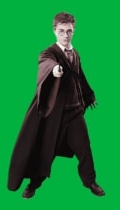

In [ ]:
q1fg_crop = np.array(q1fg[:,220:340,:])
cv2_imshow(q1fg_crop)

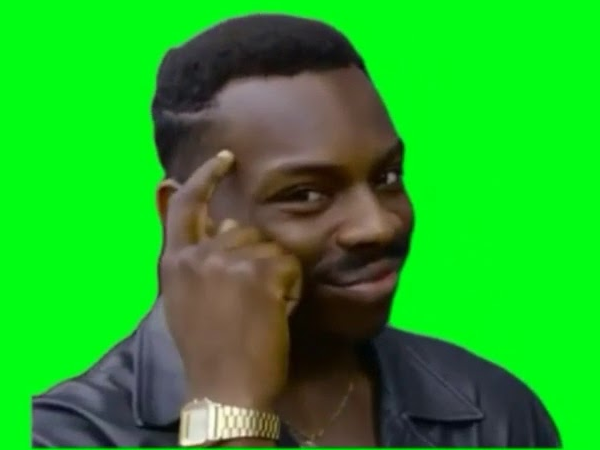

In [ ]:
q1thinking_crop = np.array(q1thinking[150:600,180:780])
cv2_imshow(q1thinking_crop)

In [ ]:
q1doc = q1bg.copy()
print(q1doc.shape)
print(q1fg_crop.shape)

(684, 795, 3)
(210, 120, 3)


In [ ]:
# def graft(bg, fg, offX=0, offY=0):
#   for r in range(fg.shape[0]):
#     for p in range(fg.shape[1]):
#       if (fg[r,p] == np.array([63,177,0])).all() == False:
#         q1doc[r, p] = q1fg_crop[r,p].copy()

In [ ]:
for r in range(q1fg_crop.shape[0]):
  for p in range(q1fg_crop.shape[1]):
    if not ((q1fg_crop[r][p][0] in range(50,70)) and (q1fg_crop[r][p][1] in range(160,190)) and (q1fg_crop[r][p][2] in range(0,10))):
      q1doc[r+450][p+300] = q1fg_crop[r][p].copy()

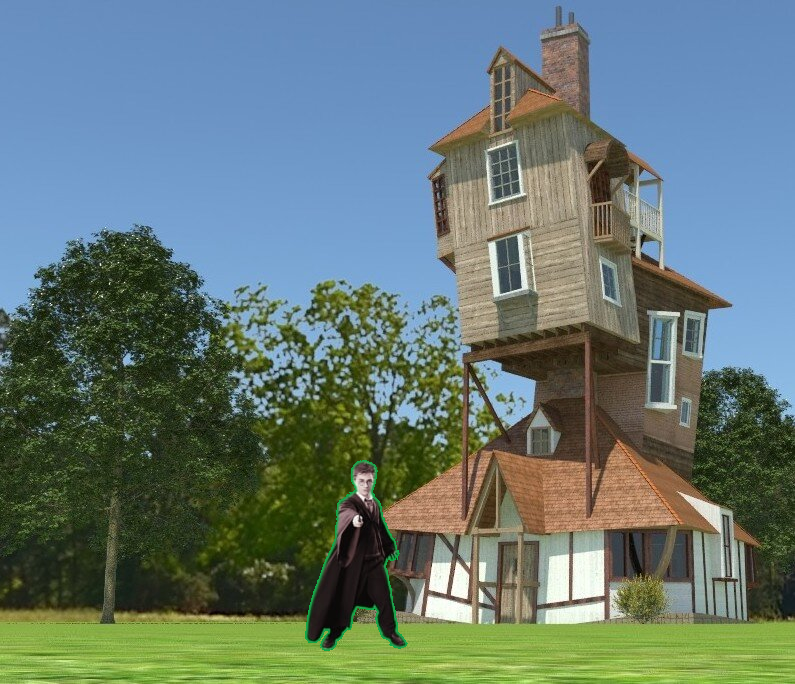

In [ ]:
cv2_imshow(q1doc)

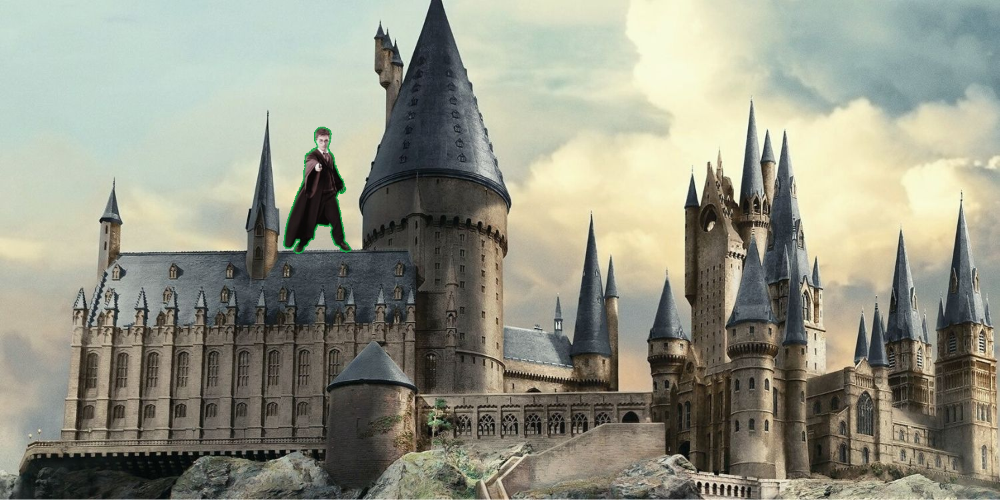

In [ ]:
for r in range(q1fg_crop.shape[0]):
  for p in range(q1fg_crop.shape[1]):
    if not ((q1fg_crop[r][p][0] in range(50,70)) and (q1fg_crop[r][p][1] in range(160,190)) and (q1fg_crop[r][p][2] in range(0,10))):
      q1hogwarts[r+180][p+420] = q1fg_crop[r][p].copy()
cv2_imshow(q1hogwarts)

In [ ]:
q1doc2 = q1bg.copy()
for r in range(q1thinking_crop.shape[0]):
  for p in range(q1thinking_crop.shape[1]):
    # if (q1thinking_crop[r,p] == np.array([20,254,0])).all() == False:

    if not ((q1thinking_crop[r][p][0] in range(10,30)) and (q1thinking_crop[r][p][1] in range(240,260)) and (q1thinking_crop[r][p][2] in range(0,10))):
      q1doc2[r+200][p] = q1thinking_crop[r][p].copy()

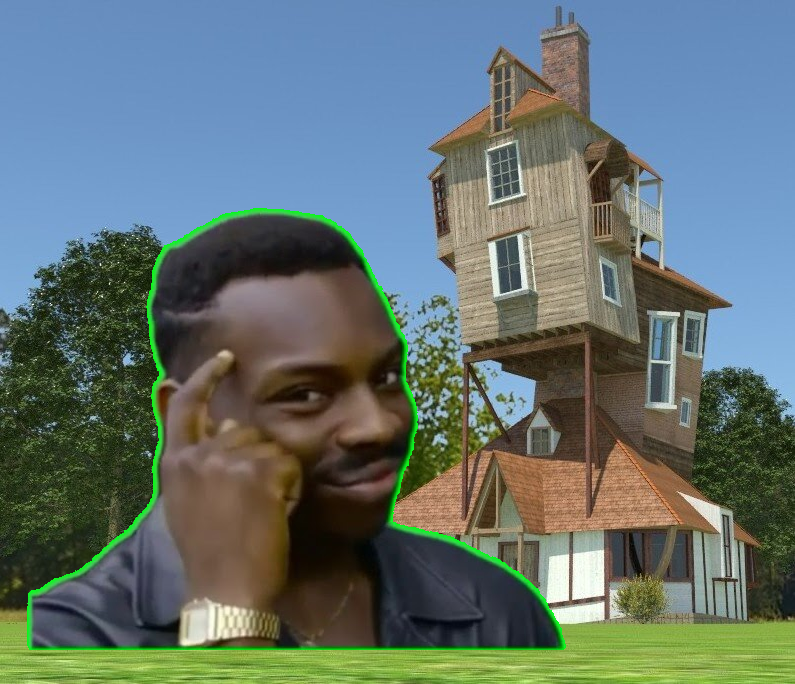

In [ ]:
cv2_imshow(q1doc2)

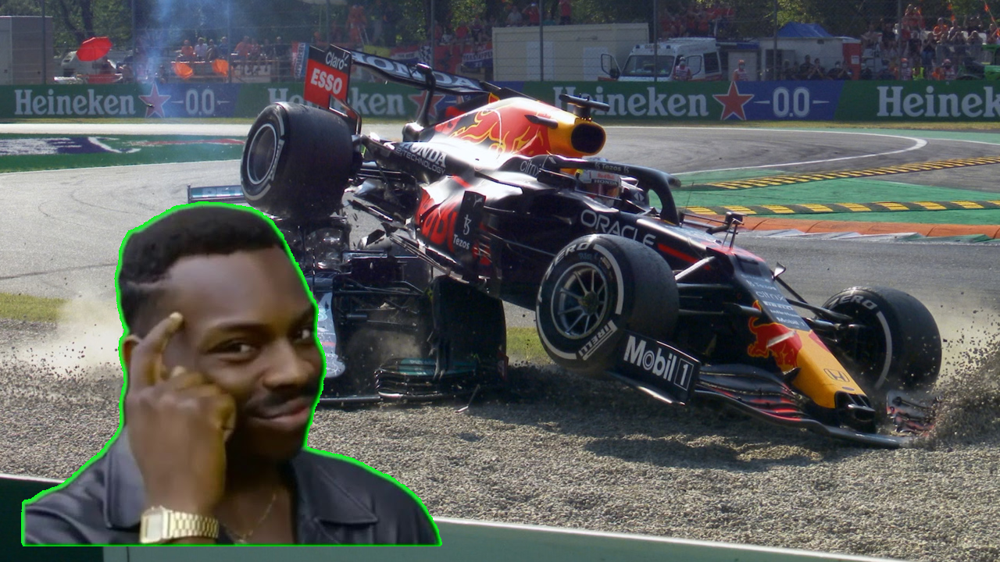

In [ ]:
q1hammax = cv2.imread("hammax.jpg")
for r in range(q1thinking_crop.shape[0]):
  for p in range(q1thinking_crop.shape[1]):
    # if (q1thinking_crop[r,p] == np.array([20,254,0])).all() == False:

    if not ((q1thinking_crop[r][p][0] in range(10,30)) and (q1thinking_crop[r][p][1] in range(240,260)) and (q1thinking_crop[r][p][2] in range(0,10))):
      q1hammax[r+250][p] = q1thinking_crop[r][p].copy()
cv2_imshow(q1hammax)

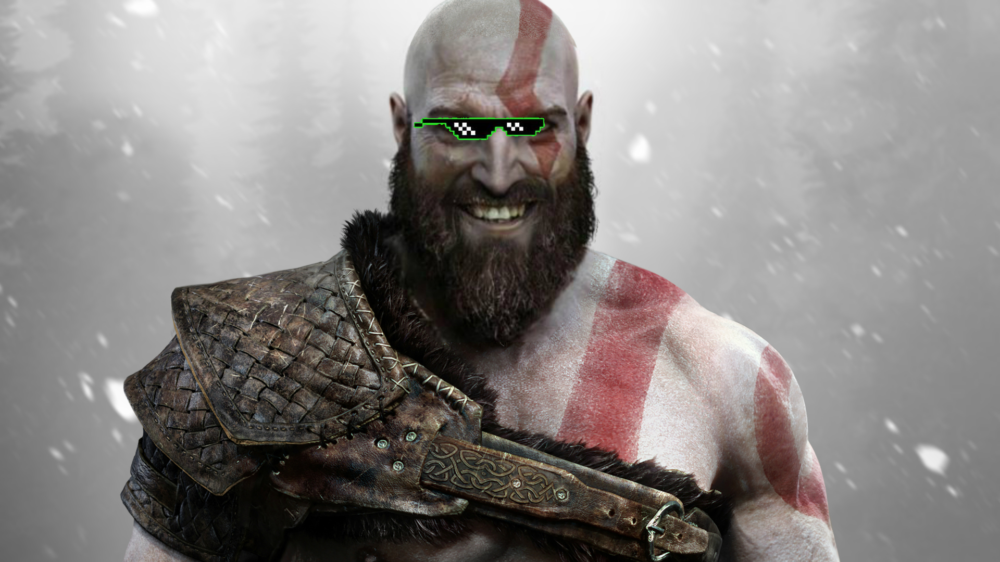

In [ ]:
q1glasses = cv2.imread("glasses.jpg")
q1kratos = cv2.imread("kratos.jpg")
for r in range(q1glasses.shape[0]):
  for p in range(q1glasses.shape[1]):
    if not ((q1glasses[r][p][0] in range(0,30)) and (q1glasses[r][p][1] in range(240,260)) and (q1glasses[r][p][2] in range(0,30))):
      q1kratos[r+210][p+790] = q1glasses[r][p].copy()

cv2_imshow(q1kratos)

## Part 2:
Moody also wants to know how many images of size 720 x 576 can be stored
if cloud of size 2 GB is available. Assuming images are stored for displaying on
standard displays, calculate the number of images you can store in the cloud.

### Answer
* 720 * 576 = 414720 pixels.
* Assuming that it is an 8-bit image, each pixel is of 24 bits.
* ```
Total size = 414720*24 
             = 9953280 bits
             = 1244160 bytes
             = 1215 kilobytes
Number of images in 2 GB = floor(2 * 1024 * 1024 / 1215) = 1726 images
```

#Question 2

* Assuming that each image is an 8-bit image with n x n resolution. Hence each pixel is 3 bytes (8 bits * 3 channels).
* Camera storage = 500 MB = 500 * 1024 * 1024 bytes = 524,288,000 bytes
* Image size = n<sup>2</sup> * 3 bytes
* Number of images = 200
* Total required size $= 200 \times 3 \times n^2 = 600n^2$
* $600n^2 \leq 524,288,000$
* $n^2 \leq 873813$ ($= 934.77^2$)
* $n = 934$
* Therefore, the image can of maximum dimensions 934 * 934


# Question 3
Given:<br>
* Focal length ($f$) = 43.5cm<br>
* Height of 1 pixel = $\frac{1}{1024}$cm<br>
* Height of image ($h_i$) = 390 pixels = $\frac{390}{1024}$cm<br>
* Object distance($u$) = 240m = 24000cm<br>
* Height of object($h_o$) = ?
From lens formula,
$
  \frac{1}{f} = \frac{1}{v} - \frac{1}{u} \
  \frac{1}{f} = \frac{1}{u}\left( 1 - \frac{h_i}{h_o}\right) \
  \frac{10}{435} = -\frac{1}{24000} \left(1 - \frac{1024h_0}{390} \right)\
  \frac{240435 * 390}{435*1024} = h_o \
  h_o =  210.5cm = 2.105m
$
<br><br>Therefore, The height of the basilisk is $2.105$ m.

#Question 4

##Part 1

In [44]:
def bitQuantizeImage(im, k):
  npim = im.copy()
  # npim = np.array([im[:,:,0] & pow(2,k), im[:,:,1] & pow(2,k), im[:,:,2] & pow(2,k)])
  for c in range(im.shape[0]):
    for p in range(im.shape[1]):
      # npim[c][p] = np.array(im[c][p][0] & pow(2,k), im[c][p][1] & pow(2,k), im[c][p][2] & pow(2,k))
      # npim[c][p][0] = (im[c][p][0] & pow(2,k)) / pow(2,k) * 255
      # npim[c][p][1] = (im[c][p][1] & pow(2,k)) / pow(2,k) * 255
      # npim[c][p][2] = (im[c][p][2] & pow(2,k)) / pow(2,k) * 255
      npim[c][p] = (im[c][p] & pow(2,k)) / pow(2,k) * 255
  # npim = np.array(np[:,:,:] & k)
  return npim

# def bitQuant(im, k):
  # for i in range(im.shape[0]):
  #   for j in range(im.shape[1]):
  #     im[i,j,0] =im[i,j,0] * 128/255
  #     im[i,j,1] =im[i,j,1] * 128/255
  #     im[i,j,2] =im[i,j,2] * 128/255
def bitQuant(im, k):
  if k>8:
    raise Exception('Cannot quantize more than the current pixels')
  first = (2**k)/ (im.max() - im.min())
  second = 255/(2**k)
  im = np.uint8(np.round((im-im.min() )* first) * second)
  return im
  

##Part2

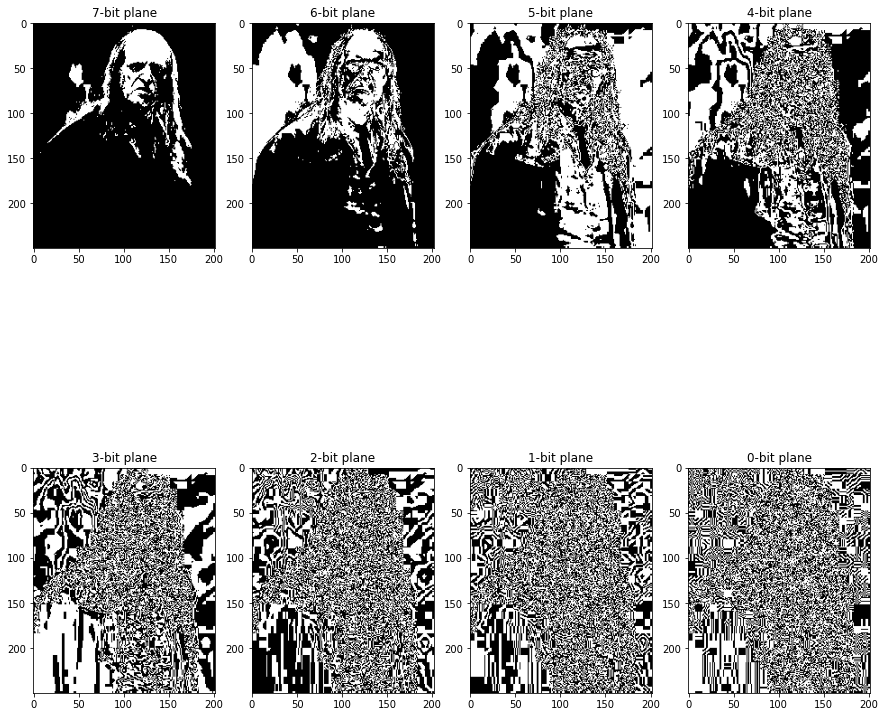

In [6]:
q4filch = cv2.imread("filch.jpg")
q4grayfilch = cv2.cvtColor(q4filch, cv2.COLOR_BGR2GRAY)
# bitQuantizeImage(q4gray, 0)
q4filch = cv2.cvtColor(q4grayfilch, cv2.COLOR_GRAY2RGB)
def bitslice(im):
  fig, axes = plt.subplots(2,4, figsize=(15,15))
  axes[0,0].imshow(bitQuantizeImage(im, 7))
  axes[0,1].imshow(bitQuantizeImage(im, 6))
  axes[0,2].imshow(bitQuantizeImage(im, 5))
  axes[0,3].imshow(bitQuantizeImage(im, 4))
  axes[1,0].imshow(bitQuantizeImage(im, 3))
  axes[1,1].imshow(bitQuantizeImage(im, 2))
  axes[1,2].imshow(bitQuantizeImage(im, 1))
  axes[1,3].imshow(bitQuantizeImage(im, 0))
  axes[0,0].set_title("7-bit plane")
  axes[0,1].set_title("6-bit plane")
  axes[0,2].set_title("5-bit plane")
  axes[0,3].set_title("4-bit plane")
  axes[1,0].set_title("3-bit plane")
  axes[1,1].set_title("2-bit plane")
  axes[1,2].set_title("1-bit plane")
  axes[1,3].set_title("0-bit plane")

bitslice(q4filch)


Text(0.5, 1.0, '8-bit')

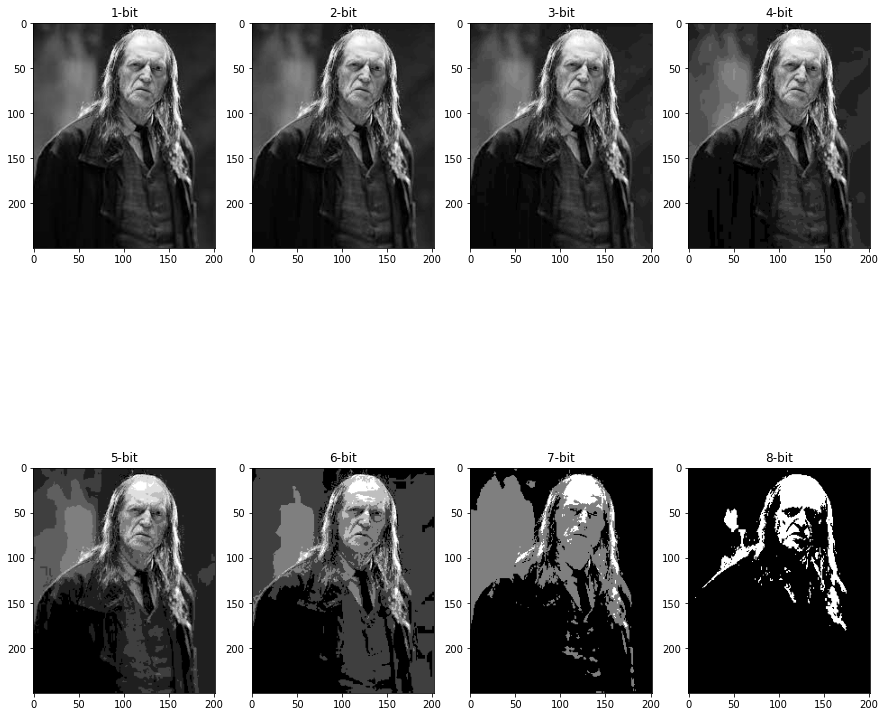

In [45]:
q4filch = cv2.imread("filch.jpg")
q4grayfilch = cv2.cvtColor(q4filch, cv2.COLOR_BGR2GRAY)
# bitQuantizeImage(q4gray, 0)
q4filch = cv2.cvtColor(q4grayfilch, cv2.COLOR_GRAY2RGB)
fig, axes = plt.subplots(2,4, figsize=(15,15))
axes[0,0].imshow(bitQuant(q4filch, 7))
axes[0,1].imshow(bitQuant(q4filch, 6))
axes[0,2].imshow(bitQuant(q4filch, 5))
axes[0,3].imshow(bitQuant(q4filch, 4))
axes[1,0].imshow(bitQuant(q4filch, 3))
axes[1,1].imshow(bitQuant(q4filch, 2))
axes[1,2].imshow(bitQuant(q4filch, 1))
axes[1,3].imshow(bitQuant(q4filch, 0))
axes[0,0].set_title("8-bit")
axes[0,1].set_title("7-bit")
axes[0,2].set_title("6-bit")
axes[0,3].set_title("5-bit")
axes[1,0].set_title("4-bit")
axes[1,1].set_title("3-bit")
axes[1,2].set_title("2-bit")
axes[1,3].set_title("1-bit")



##Part 3

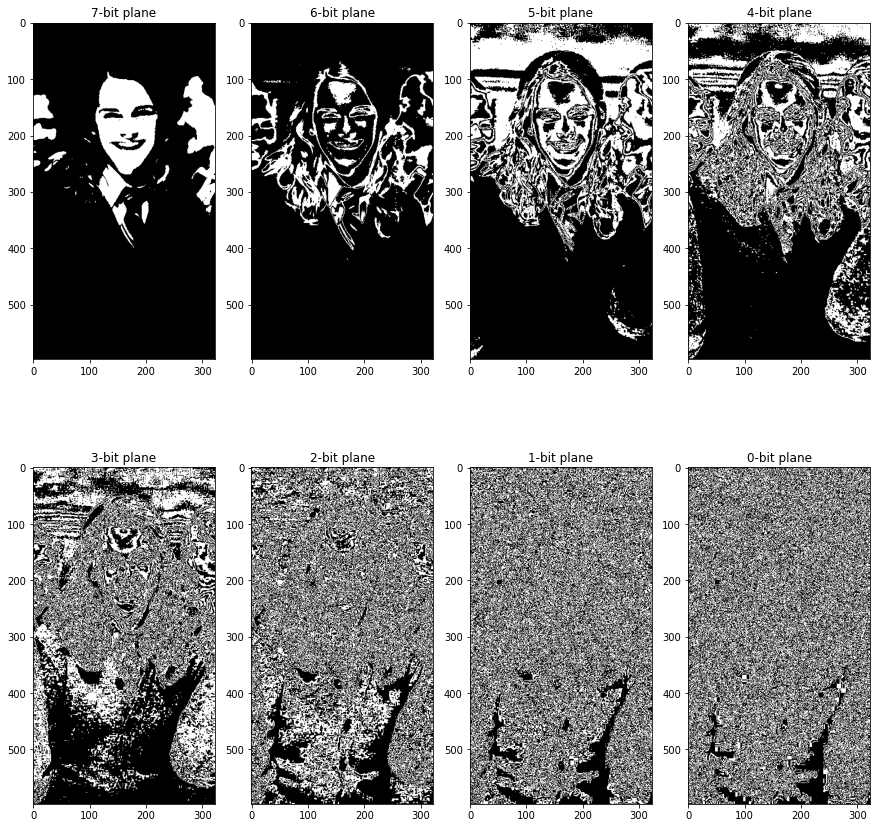

In [7]:
q4herm = cv2.imread("hermoine.jpg")
q4grayherm = cv2.cvtColor(q4herm, cv2.COLOR_BGR2GRAY)
# bitQuantizeImage(q4gray, 0)
q4herm = cv2.cvtColor(q4grayherm, cv2.COLOR_GRAY2RGB)
bitslice(q4herm)

Text(0.5, 1.0, '1-bit')

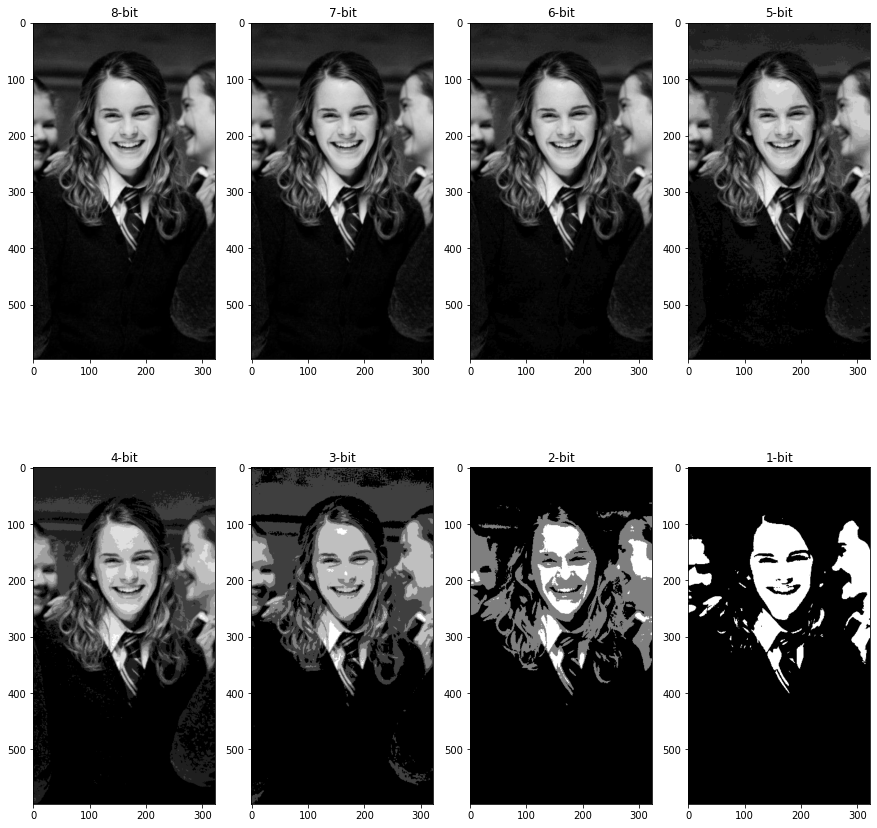

In [47]:
q4hermoine = cv2.imread("hermoine.jpg")
q4grayhermoine = cv2.cvtColor(q4hermoine, cv2.COLOR_BGR2GRAY)
# bitQuantizeImage(q4gray, 0)
q4hermoine = cv2.cvtColor(q4grayhermoine, cv2.COLOR_GRAY2RGB)
fig, axes = plt.subplots(2,4, figsize=(15,15))
axes[0,0].imshow(bitQuant(q4hermoine, 7))
axes[0,1].imshow(bitQuant(q4hermoine, 6))
axes[0,2].imshow(bitQuant(q4hermoine, 5))
axes[0,3].imshow(bitQuant(q4hermoine, 4))
axes[1,0].imshow(bitQuant(q4hermoine, 3))
axes[1,1].imshow(bitQuant(q4hermoine, 2))
axes[1,2].imshow(bitQuant(q4hermoine, 1))
axes[1,3].imshow(bitQuant(q4hermoine, 0))
axes[0,0].set_title("8-bit")
axes[0,1].set_title("7-bit")
axes[0,2].set_title("6-bit")
axes[0,3].set_title("5-bit")
axes[1,0].set_title("4-bit")
axes[1,1].set_title("3-bit")
axes[1,2].set_title("2-bit")
axes[1,3].set_title("1-bit")

##Part 4
The transform function in this case is complex.
Firstly, we compute the negative of the image. This is done by converting to grayscale and then replacing pixel intensity i with 255-i.
Second, we scale it to 7-bit colour space (contrast shrinking, if you will).
Third, if the pixel intensity > 16, then we subtract it by 16 and mutiply with 128/112 to maintain contrast. If the pixel intensity is <= 16, we set it to 0.

This was the closest transform I could achieve.

So in the former case the transform is:
$s = ((\frac{128}{255} \times (255 - \frac{r+g+b}{3})^2) - 16) \times 128/112$<br>
In the latter case the transform is: $s = 0$

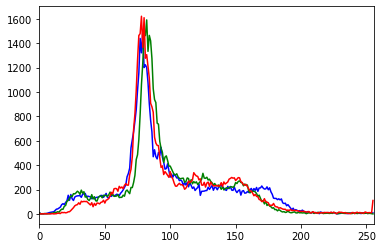

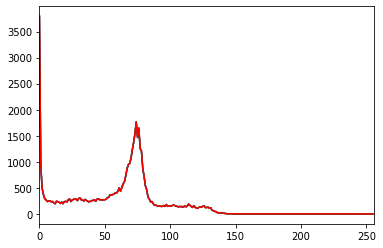

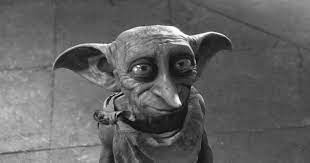

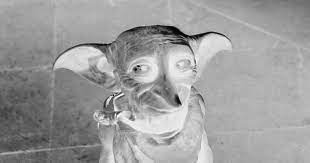

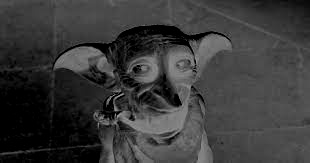

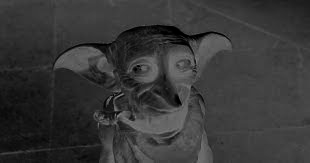

[[66 66 66 ... 28 28 28]
 [67 67 67 ... 28 28 28]
 [68 68 68 ... 29 28 28]
 ...
 [25 29 29 ... 67 67 67]
 [25 29 29 ... 67 67 67]
 [25 29 29 ... 67 67 67]]


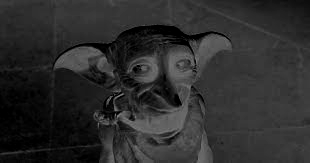

[[57 57 57 ... 13 13 13]
 [58 58 58 ... 13 13 13]
 [59 59 59 ... 14 13 13]
 ...
 [10 14 14 ... 58 58 58]
 [10 14 14 ... 58 58 58]
 [10 14 14 ... 58 58 58]]


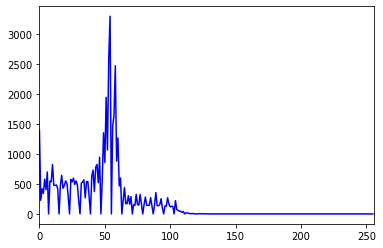

In [8]:
q4dobby = cv2.imread("dobby.jpg")
q4dobby_corrupt = cv2.imread("dobby_corrupt.jpg")
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([q4dobby],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()
for i,col in enumerate(color):
    histr = cv2.calcHist([q4dobby_corrupt],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

q4dobby_gray = cv2.cvtColor(q4dobby, cv2.COLOR_BGR2GRAY)
cv2_imshow(q4dobby_gray)
q4dobby_notgray = np.array(-q4dobby_gray[:,:])
cv2_imshow(q4dobby_notgray)



# q4_matched = exposure.match_histograms(q4dobby_notgray, q4dobby_gray, multichannel=False)
# cv2_imshow(q4_matched)


q4dobby_b = np.array(q4dobby[:,:,0])
q4dobby_g = np.array(q4dobby[:,:,1])
q4dobby_r = np.array(q4dobby[:,:,2])
q4dobby_gamma = np.array(128*(q4dobby_notgray/255) ** 1.8, dtype= 'uint8')
cv2_imshow(q4dobby_corrupt)
cv2_imshow(q4dobby_gamma)

# histr = cv2.calcHist([q4dobby_gamma],[0],None,[256],[0,256])
# plt.plot(histr,color = 'b')
# plt.xlim([0,256])
print(q4dobby_gamma)
# for row in q4dobby_gamma:
#   for pixel in row:
#     print(pixel)
#     pixel = (pixel - 128)
#     if pixel < 0: pixel = 0
# histr = cv2.calcHist([q4dobby_gamma],[0],None,[256],[0,256])
# plt.plot(histr,color = 'b')
# plt.xlim([0,256])
# print(q4dobby_gamma)

for i in range(q4dobby_gamma.shape[0]):
  for j in range(q4dobby_gamma.shape[1]):
    if q4dobby_gamma[i][j] > 16: q4dobby_gamma[i][j] = q4dobby_gamma[i][j] - 16
    else: q4dobby_gamma[i][j] = 0
    q4dobby_gamma[i][j] = q4dobby_gamma[i][j]/112 * 128

cv2_imshow(q4dobby_gamma)
print(q4dobby_gamma)
histr = cv2.calcHist([q4dobby_gamma],[0],None,[256],[0,256])
plt.plot(histr,color = 'b')
plt.xlim([0,256])

# for i,col in enumerate(color):
#     histr = cv2.calcHist([q4dobby_gamma],[i],None,[256],[0,256])
#     plt.plot(histr,color = col)
#     plt.xlim([0,256])
plt.show()

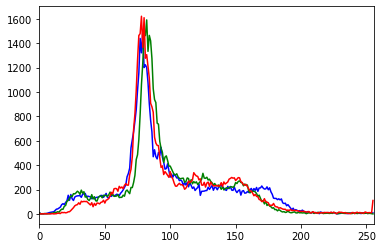

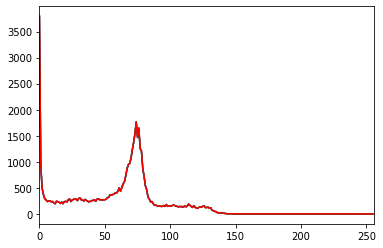

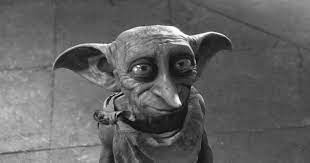

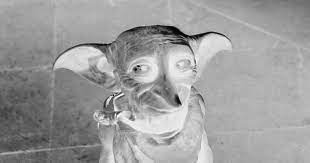

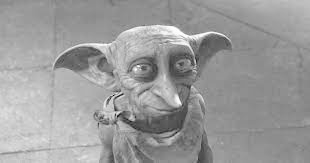

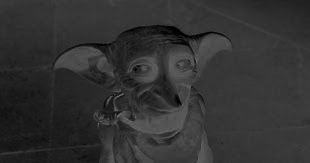

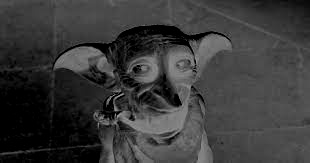

(0.0, 256.0)

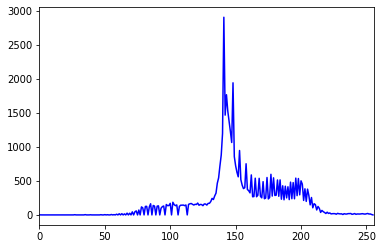

In [9]:
q4dobby = cv2.imread("dobby.jpg")
q4dobby_corrupt = cv2.imread("dobby_corrupt.jpg")
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([q4dobby],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()
for i,col in enumerate(color):
    histr = cv2.calcHist([q4dobby_corrupt],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

q4dobby_gray = cv2.cvtColor(q4dobby, cv2.COLOR_BGR2GRAY)
cv2_imshow(q4dobby_gray)
q4dobby_notgray = np.array(-q4dobby_gray[:,:])
cv2_imshow(q4dobby_notgray)

# q4dobby_gamma = np.array(q4dobby_notgray)
q4dobby_gamma = np.array(255*(q4dobby_gray/255) ** 0.5, dtype= 'uint8')
q4dobby_notgamma = np.array(-q4dobby_gamma[:,:])
q4dobby_notgamma = np.array(q4dobby_notgamma[:,:] / 2)


# for i in range(q4dobby_gamma.shape[0]):
#   for j in range(q4dobby_gamma.shape[1]):
#     if q4dobby_gamma[i][j] > 64: q4dobby_gamma[i][j] = q4dobby_gamma[i][j] - 64
#     else: q4dobby_gamma[i][j] = 0
#     q4dobby_gamma[i][j] = q4dobby_gamma[i][j]/192 * 128

cv2_imshow(q4dobby_gamma)
cv2_imshow(q4dobby_notgamma)
cv2_imshow(q4dobby_corrupt)
histr = cv2.calcHist([q4dobby_gamma],[0],None,[256],[0,256])
plt.plot(histr,color = 'b')
plt.xlim([0,256])

#Question 5

##Part 1

In [107]:
q5src = cv2.imread("phoenix-bad.jpg")
def linContrastStretching(im, a, b):
  # cv2_imshow(im)
  min_b = np.min(im[:,:,0])
  min_g = np.min(im[:,:,1])
  min_r = np.min(im[:,:,2])
  
  max_b = np.max(im[:,:,0])
  max_g = np.max(im[:,:,1])
  max_r = np.max(im[:,:,2])

  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      im[i,j,0] = (im[i,j,0] - min_b) / (max_b - min_b) * (b-a) + a
      im[i,j,1] = (im[i,j,1] - min_g) / (max_g - min_g) * (b-a) + a
      im[i,j,2] = (im[i,j,2] - min_r) / (max_r - min_r) * (b-a) + a
  # cv2_imshow(im)
  return im

def colorbar(im, k):
  from collections import Counter
  from itertools import chain
  cnt = Counter([(j[0],j[1],j[2]) for i in im for j in i])
  # print(cnt)
  # print(cnt.most_common(2))
  top_k = cnt.most_common(k)
  top_k_dic = {}
  for i in top_k:
    top_k_dic[i[0]] = i[1]

  # colbar = np.zeroes((50,200*k))
  plt.bar(range(k), list(top_k_dic.values()), align='center')
  plt.xticks(range(k), list(top_k_dic.keys()))


##Part 2

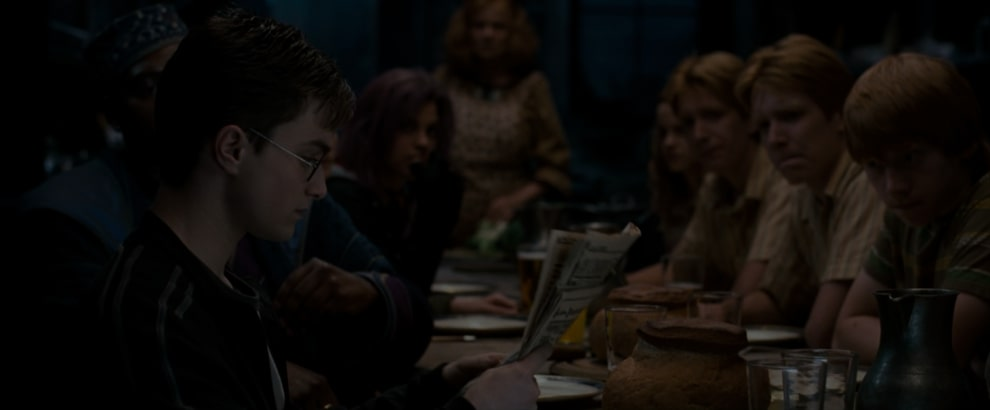

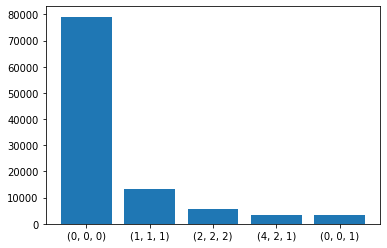

In [108]:
q5lit = linContrastStretching(q5src.copy(), 0, 255)
cv2_imshow(q5src)
colorbar(q5src, 5)

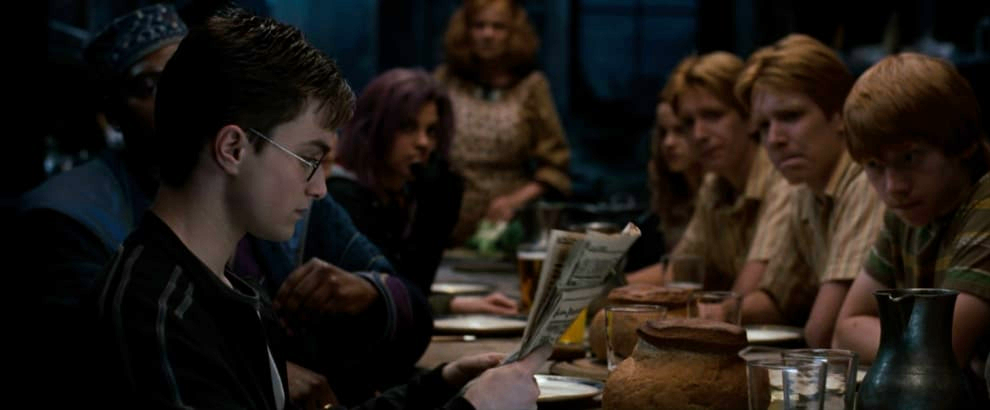

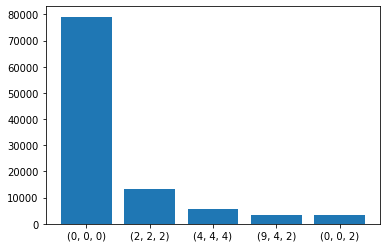

In [109]:
cv2_imshow(q5lit)
colorbar(q5lit, 5)

##Part 3

#Question 6

##Part 1

In [ ]:
def piecewiseLinTransform(im,k1,k2,a,b):
  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      for k in range(len(a)):
        if im[i,j] in range(int(255*a[k]), int(255*b[k])):
          im[i,j] = int(im[i,j]*k1[k] + 255*k2[k])
  cv2_imshow(im)


##Part 2

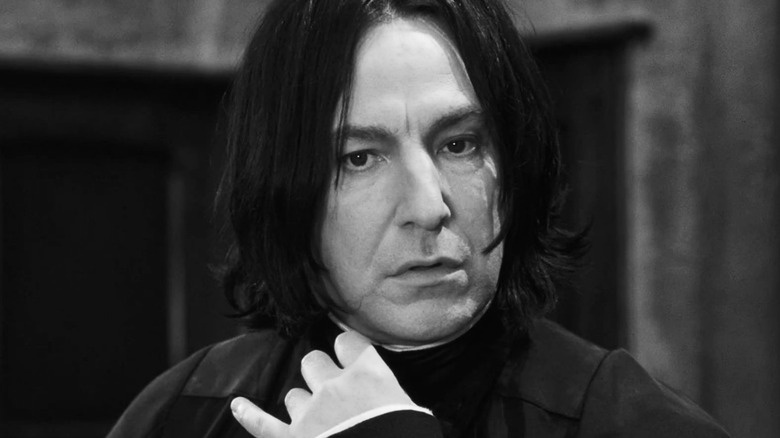

In [ ]:
q6snape = cv2.imread("snape1.jpg")
q6hagrid = cv2.imread("hagrid.jpg")

k1_snape = [1,-2,1,-2,1,-2,0]
k2_snape = [0,0.6,-0.3,1.2,-0.6,1.8,0]
a_snape  = [0.0,0.2,0.3,0.5,0.6,0.8,0.9]
b_snape  = [0.2,0.3,0.5,0.6,0.8,0.9,1.0]

k1_hagrid = [0,0,7,-7,0,0]
k2_hagrid = [0,0.2,-1.2,3.0,0.2,0]
a_hagrid  = [0.0,0.1,0.2,0.3,0.4,0.5]
b_hagrid  = [0.1,0.2,0.3,0.4,0.5,1.0]

q6snape = cv2.cvtColor(q6snape, cv2.COLOR_BGR2GRAY)
q6hagrid = cv2.cvtColor(q6hagrid, cv2.COLOR_BGR2GRAY)

cv2_imshow(q6snape)


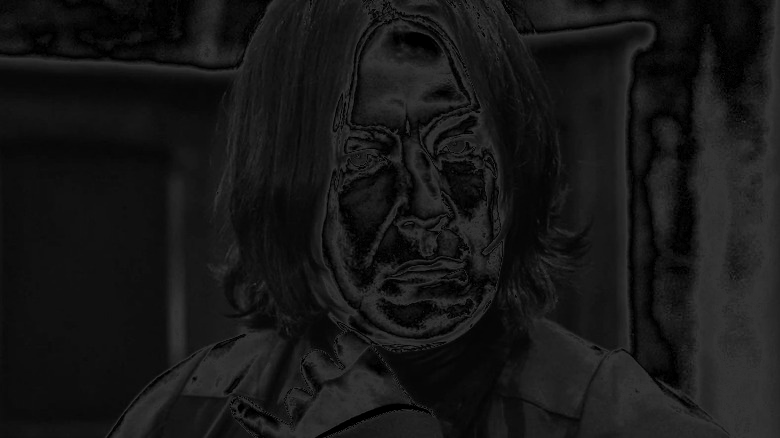

In [ ]:
piecewiseLinTransform(q6snape,k1_snape,k2_snape,a_snape,b_snape)

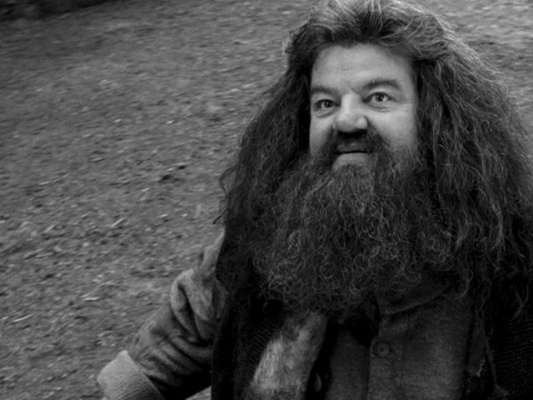

In [ ]:
cv2_imshow(q6hagrid)

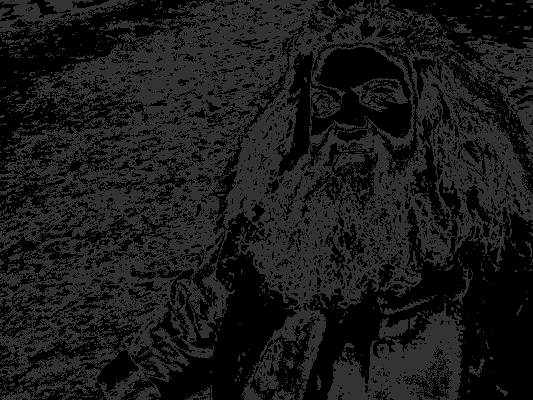

In [ ]:
piecewiseLinTransform(q6hagrid,k1_hagrid,k2_hagrid,a_hagrid,b_hagrid)

## Explanation
In a piecewise linear transform, we generate a mapping (generally 1->1 mapping) and transform each pixel according the piece in the piecewise function it belongs to.
For example, if my function is s = 1.2r for (0, 127) and 2r for (128, 255) and if the current pixel has intensity 60, we see that it is in the range (0, 127) and calculate the new intensity as s = 1.2 * (60) = 72.

Therefore, for each pixel we check what piece of the function to apply and then we transform the pixel value accordingly.

##Part 3

Contrast stretching can be used to reveal obscured details in order to view them in much more detail. In this examples, we can reveal the retinas in any eye with more detail.

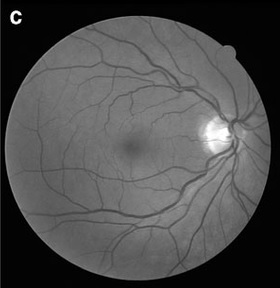

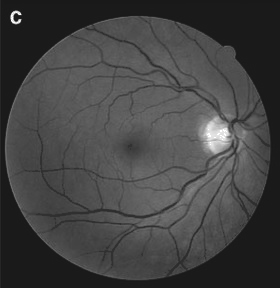

In [ ]:
q6retina = cv2.imread("retina.jpg")
cv2_imshow(q6retina)
q6retina = cv2.cvtColor(q6retina, cv2.COLOR_BGR2GRAY)

# k1_retina = [0.3,0.3,0.8]
# k2_retina = [0,0,0]
# a_retina = [0.0,0.2,0.365]
# b_retina = [0.2,0.365,1]
k1_retina = [0.3,0.3,1]
k2_retina = [0.1,0.1,-0.1]
a_retina = [0.0,0.2,0.34]
b_retina = [0.2,0.34,1]

piecewiseLinTransform(q6retina,k1_retina,k2_retina,a_retina,b_retina)

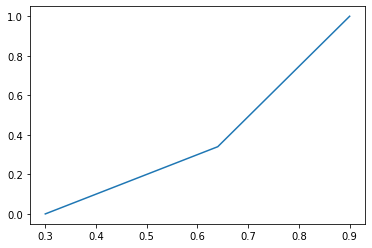

In [112]:
x = [0.3,0.5,0.64,0.9]
y = [0.0,0.2,0.34,1.0]
plt.plot(x,y,'-')
plt.show()

#Question 7

##Part 1

In [ ]:
def histEqualization(im):
  # im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
  L = 256
  count = [0] * L
  prob = [0] * L
  target = [0] * L
  total_pixels = im.shape[0] * im.shape[1]
  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      count[im[i,j]] += 1
  prob = [x / total_pixels for x in count]

  
  sum = 0
  for i in range(L):
    sum += prob[i]
    target[i] = int((L-1)*sum)

  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      im[i,j] = target[im[i,j]]
  return im

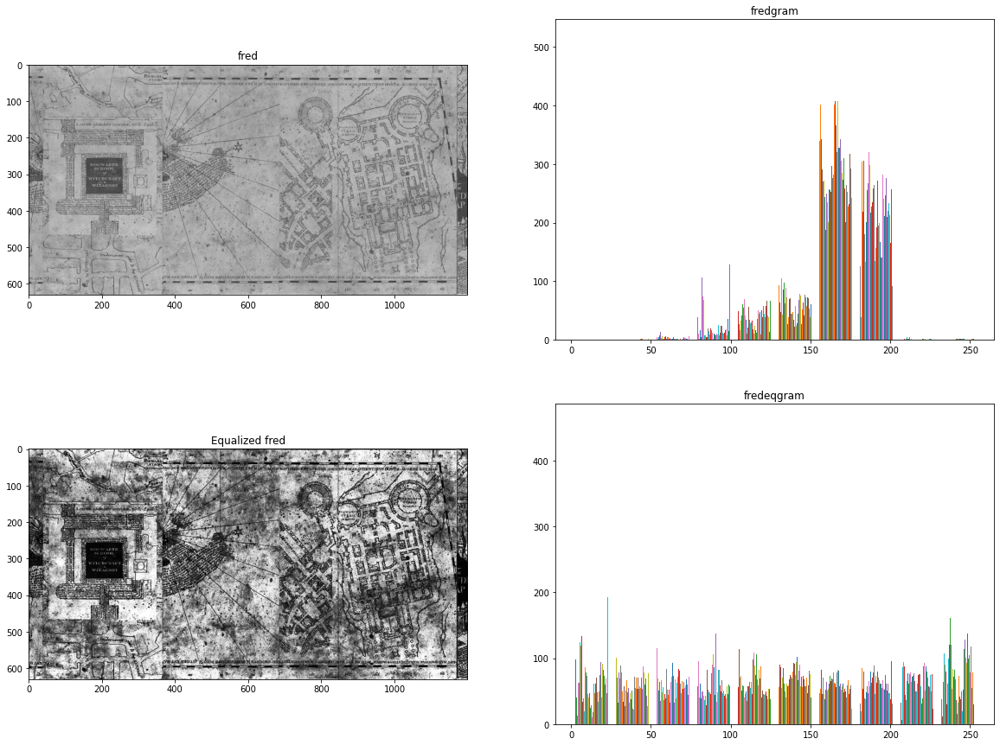

In [ ]:
q7fred = cv2.imread("map-reference.jpeg", 0)
# cv2_imshow(q7fred)
# plt.hist(q7fred.ravel(),256,[0,256], stacked=False); plt.show()
fig = plt.figure(figsize=(20,15))

# show original image
fig.add_subplot(221)
plt.title('fred')
plt.set_cmap('gray')
plt.imshow(q7fred)

fig.add_subplot(222)
plt.title('fredgram')
plt.hist(q7fred,10,range=(0,255))

q7fredeq = histEqualization(q7fred)

fig.add_subplot(223)
plt.title('Equalized fred')
plt.set_cmap('gray')
plt.imshow(q7fredeq)

fig.add_subplot(224)
plt.title('fredeqgram')
plt.hist(q7fredeq,10,range=(0,255))

plt.show()

In [ ]:
def histMatching(im, ref_im):
  # im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
  L = 256
  count = [0] * L
  prob = [0] * L
  prob_ref = [0] * L
  prob_ref_inv = [0] * L
  target = [0] * L
  target_ref = [0] * L
  target_ref_inv = [0] * L

  # For the main image
  total_pixels = im.shape[0] * im.shape[1]
  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      count[im[i,j]] += 1
  prob = [x / total_pixels for x in count]
  sum = 0
  for i in range(L):
    sum += prob[i]
    target[i] = int((L-1)*sum)

  # For the reference image
  count = [0] * L
  total_pixels = ref_im.shape[0] * ref_im.shape[1]
  for i in range(ref_im.shape[0]):
    for j in range(ref_im.shape[1]):
      count[ref_im[i,j]] += 1
  prob = [x / total_pixels for x in count]
  sum = 0
  for i in range(L):
    sum += prob[i]
    target_ref[i] = int((L-1)*sum)

  for p in range(256):
    target_ref_inv[target_ref[p]] = p

  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      im[i,j] = target_ref_inv[target[im[i,j]]]
  return im

In [ ]:
def histMatching_np(im, ref_im):
  # im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
  L = 256
  count = [0] * L
  prob = [0] * L
  prob_ref = [0] * L
  prob_ref_inv = [0] * L
  target = [0] * L
  target_ref = [0] * L
  target_ref_inv = [0] * L

  # For the main image: calculated the map in target[]
  total_pixels = im.shape[0] * im.shape[1]
  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      count[im[i,j]] += 1
  prob = [x / total_pixels for x in count]
  sum = 0
  for i in range(L):
    sum += prob[i]
    target[i] = round((L-1)*sum)

  # For the reference image: calculating the map in target_ref[]
  count = [0] * L
  total_pixels = ref_im.shape[0] * ref_im.shape[1]
  for i in range(ref_im.shape[0]):
    for j in range(ref_im.shape[1]):
      count[ref_im[i,j]] += 1
  prob = [x / total_pixels for x in count]
  sum = 0
  for i in range(L):
    sum += prob[i]
    target_ref[i] = round((L-1)*sum)

  # Calculating the inverse of target_ref[]
  for p in range(256):
    target_ref_inv[target_ref[p]] = p
  # for p in range(256):
    # try:
    #   target_ref_inv[p] = target_ref.index(p)
    # except:
    #   target_ref_inv[p] = target_ref_inv[p-1]
  # Transforming image
  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      im[i,j] = target_ref_inv[target[im[i,j]]]
  return im

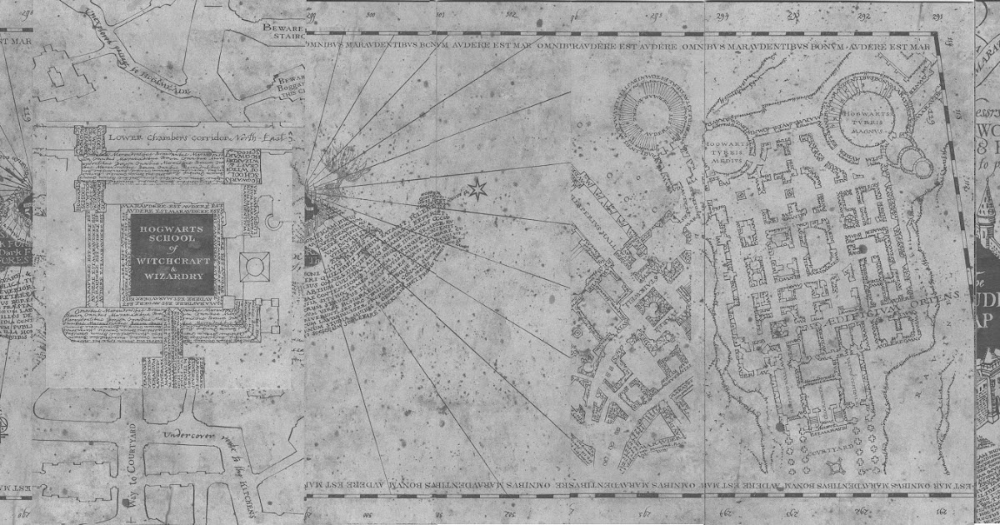

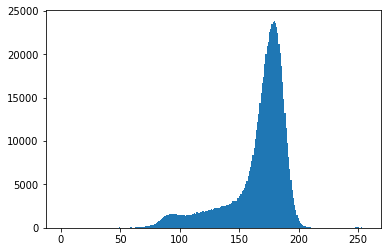

In [ ]:
q7test = cv2.imread("map-reference.jpeg", 0)
cv2_imshow(q7test)
plt.hist(q7test.ravel(),256,[0,256]); plt.show()

(1080, 1920) (630, 1200)
(630, 1200) (630, 1200)


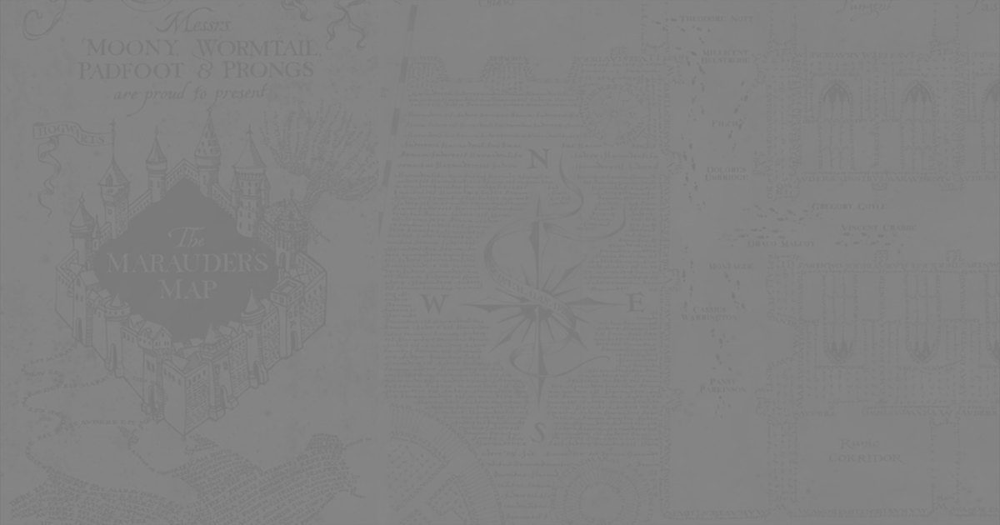

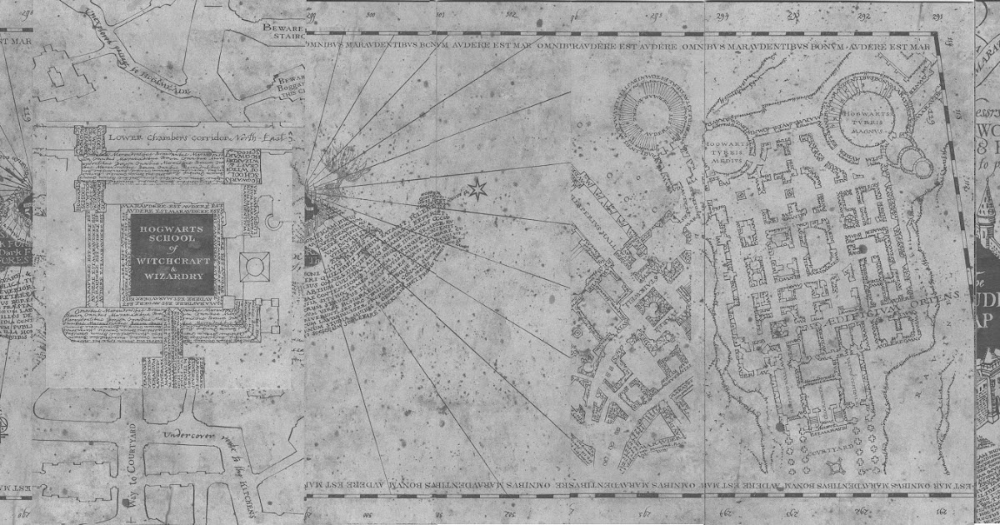

In [ ]:
q7map = cv2.imread("map.jpeg", 0)
q7map_ref = cv2.imread("map-reference.jpeg", 0)
print(q7map.shape, q7map_ref.shape)
q7map = cv2.resize(q7map, (1200,630))
print(q7map.shape, q7map_ref.shape)
cv2_imshow(q7map)
cv2_imshow(q7map_ref)

In [1]:
q7map = cv2.imread("map.jpeg", 0)
# q7map = cv2.resize(q7map, (1200,630))
q7map_ref = cv2.imread("map-reference.jpeg", 0)
q7map_ref = cv2.resize(q7map_ref, (1920,1080))
cv2_imshow(q7map)
plt.hist(q7map.ravel(),256,[0,256]); plt.show()
# plt.hist(q7fred.ravel(),256,[0,256], stacked=False); plt.show()
fig = plt.figure(figsize=(20,15))

# show original image
fig.add_subplot(321)
plt.title('map')
plt.set_cmap('gray')
plt.imshow(q7map)

fig.add_subplot(322)
plt.title('mapgram')
plt.hist(q7map,10,range=(0,255))

q7map_matched = q7map.copy()
q7map_matched = histMatching(q7map_matched, q7map_ref)

fig.add_subplot(323)
plt.title('Matched map')
plt.set_cmap('gray')
plt.imshow(q7map_matched)

fig.add_subplot(324)
plt.title('mapgram_matched')
plt.hist(q7map_matched,10,range=(0,255))

fig.add_subplot(325)
plt.title('Reference map')
plt.set_cmap('gray')
plt.imshow(q7map_ref)

fig.add_subplot(326)
plt.title('mapgram_matched')
plt.hist(q7map_ref,10,range=(0,255))

plt.show()

NameError: ignored

#Question 8

In [52]:
def gammaTransform(im, gam):
  cv2_imshow(im)
  im_gamma = np.array(255*((im/255) ** gam), dtype= 'uint8')
  cv2_imshow(im_gamma)
  return im_gamma

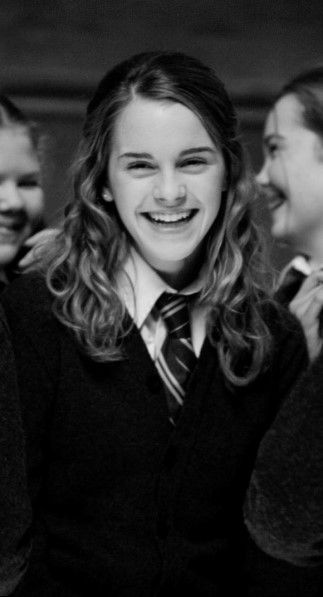

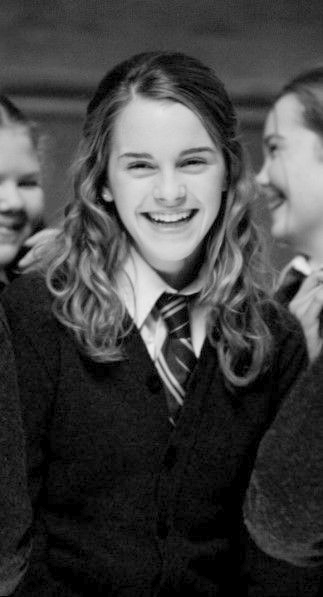

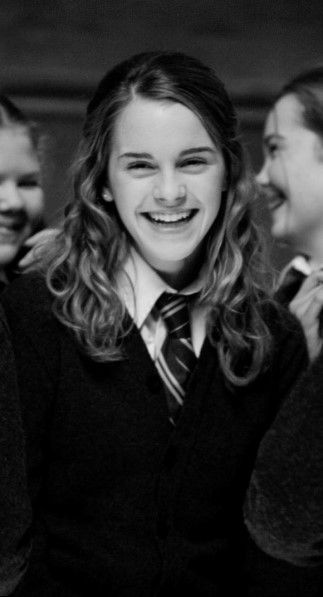

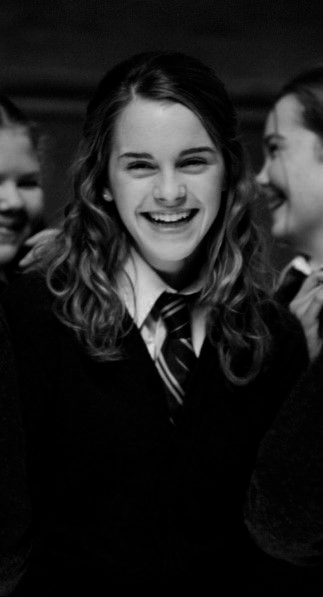

In [54]:
q8first = cv2.imread("hermoine.jpg", 0)
q8first_lowgamma = gammaTransform(q8first, 0.7)
q8first_highgamma = gammaTransform(q8first, 1.4)

Observations:
When we lower the gamma, we notice that the pixel intensities tend to shift towards higher intensity in an exponential fashion. Therefore, pixels with lower orignal intensities become closer to pixels of higher intensities. It brightens the image.

Similarly, when we raise the gamma, the intensities tend to shit towards low intensity, and pixels iwth higher original intensities become closer to pixels of lower intensities. It darkens the image.

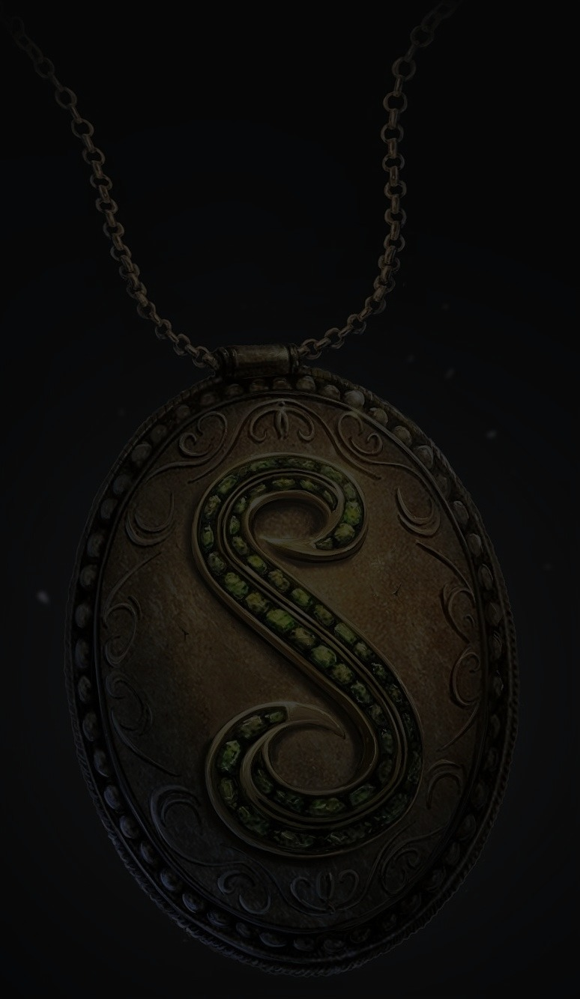

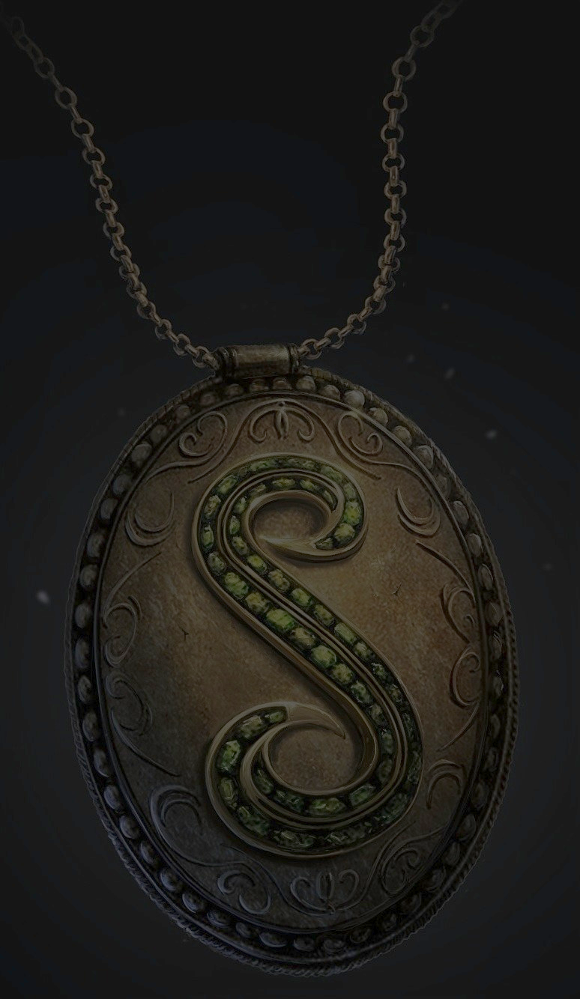

In [ ]:
q8 = cv2.imread("locket.jpeg")
gammaTransform(q8, 0.7)

Observation:
Here we notice that many details that were hidden in the low brighness of the original picture are now revealed while relatively maintaining overall contrast direction of the image. 

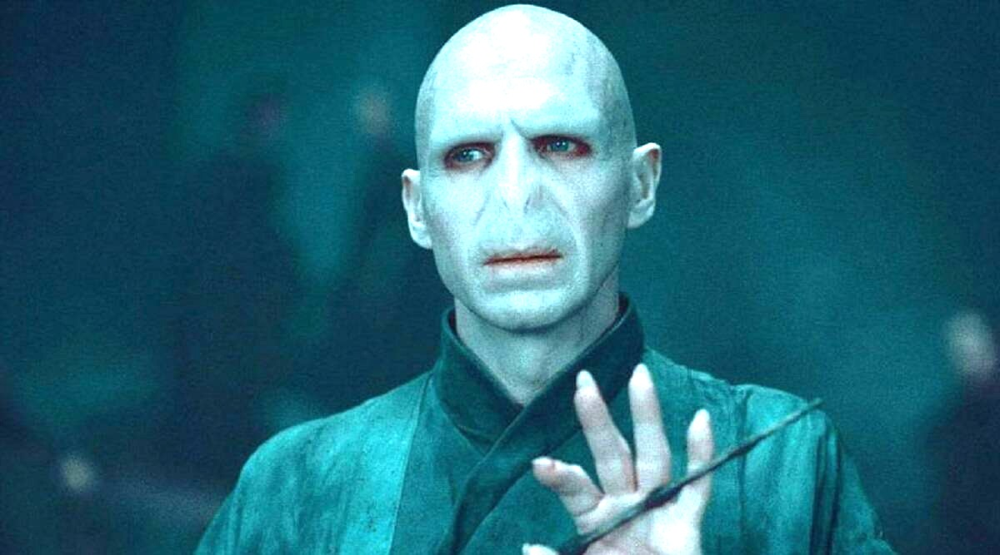

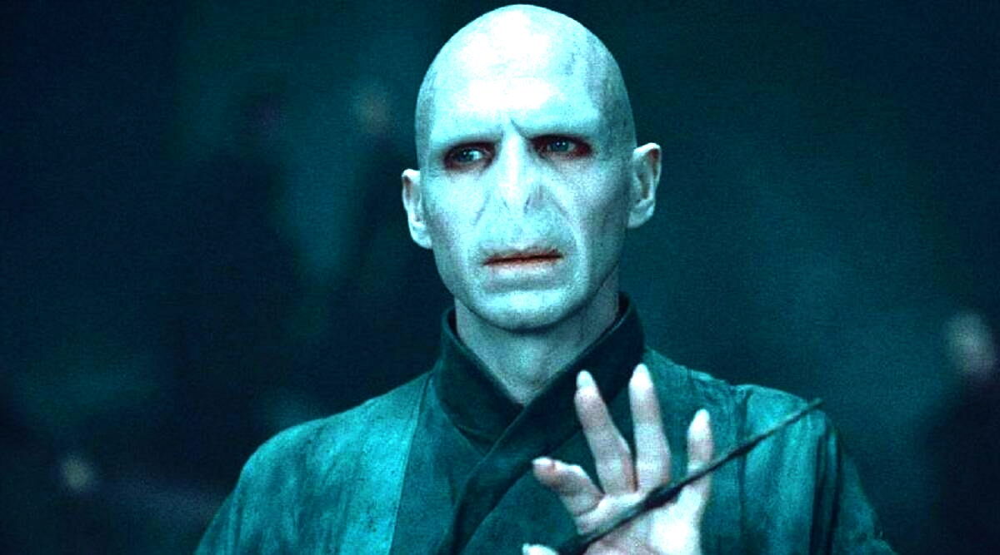

In [ ]:
q8 = cv2.imread("voldemort.jpeg")
gammaTransform(q8, 1.5)

Observation: 
Here we notice that the details that were occluded by high brightness have now been revealed by transforming the image on high gamma. If we look at the region near Voldemort's (supposed) nose, we can see more details that were previously hidden.

#Question 9

In [ ]:
def gammaTransform9(im, gam):
  # cv2_imshow(im)
  im_gamma = np.array(255*((im/255) ** gam), dtype= 'uint8')
  # cv2_imshow(im_gamma)
  return im_gamma

In [ ]:
def histEqualization(im):
  # im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
  L = 256
  count = [0] * L
  prob = [0] * L
  target = [0] * L
  total_pixels = im.shape[0] * im.shape[1]
  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      count[im[i,j]] += 1
  prob = [x / total_pixels for x in count]

  
  sum = 0
  for i in range(L):
    sum += prob[i]
    target[i] = int((L-1)*sum)

  for i in range(im.shape[0]):
    for j in range(im.shape[1]):
      im[i,j] = target[im[i,j]]
  return im

In [ ]:
def stitchfinal(q9nev1, q9nev2, q9nev3, q9nev4):
  q9nevleft = cv2.vconcat([q9nev1,q9nev2])
  q9nevright = cv2.vconcat([q9nev3,q9nev4])
  q9nevfull = cv2.hconcat([q9nevleft,q9nevright])

  cv2_imshow(q9nevfull)

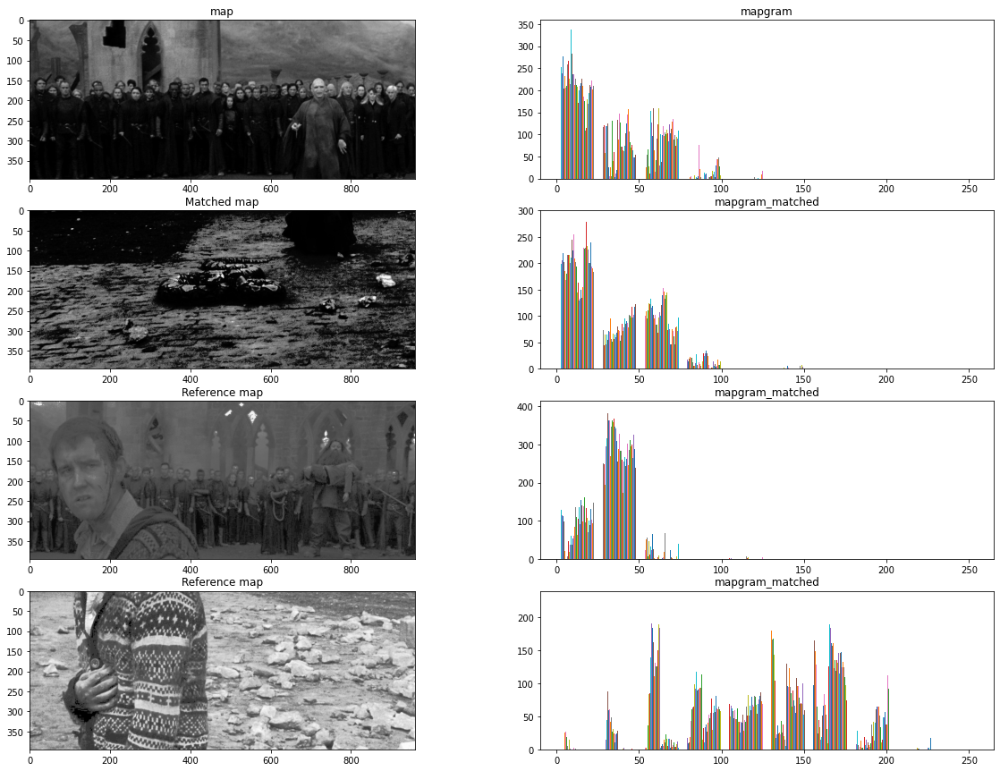

In [ ]:
q9nev1 = cv2.imread("neville1.jpg",0)
q9nev2 = cv2.imread("neville2.jpg",0)
q9nev3 = cv2.imread("neville3.jpg",0)
q9nev4 = cv2.imread("neville4.jpg",0)

fig = plt.figure(figsize=(20,15))

# show original image
fig.add_subplot(421)
plt.title('map')
plt.set_cmap('gray')
plt.imshow(q9nev1)

fig.add_subplot(422)
plt.title('mapgram')
plt.hist(q9nev1,10,range=(0,255))

fig.add_subplot(423)
plt.title('Matched map')
plt.set_cmap('gray')
plt.imshow(q9nev2)

fig.add_subplot(424)
plt.title('mapgram_matched')
plt.hist(q9nev2,10,range=(0,255))

fig.add_subplot(425)
plt.title('Reference map')
plt.set_cmap('gray')
plt.imshow(q9nev3)

fig.add_subplot(426)
plt.title('mapgram_matched')
plt.hist(q9nev3,10,range=(0,255))

fig.add_subplot(427)
plt.title('Reference map')
plt.set_cmap('gray')
plt.imshow(q9nev4)

fig.add_subplot(428)
plt.title('mapgram_matched')
plt.hist(q9nev4,10,range=(0,255))

plt.show()

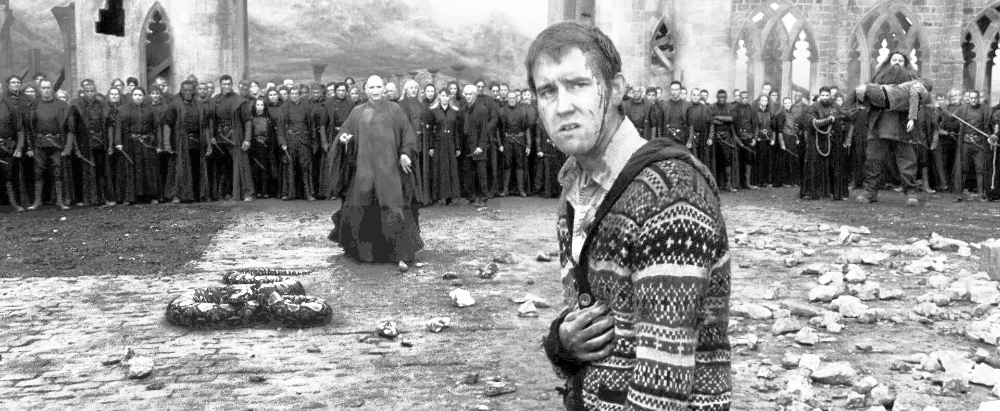

In [ ]:
# stitchfinal(gammaTransform9(q9nev1, 0.6), gammaTransform9(q9nev2, 1), gammaTransform9(q9nev3, 1), gammaTransform9(q9nev4, 1))
stitchfinal(gammaTransform9(histEqualization(q9nev1), 1.3), gammaTransform9(histEqualization(q9nev2), 0.6), gammaTransform9(histEqualization(q9nev3), 1), gammaTransform9(histEqualization(q9nev4), 0.6))

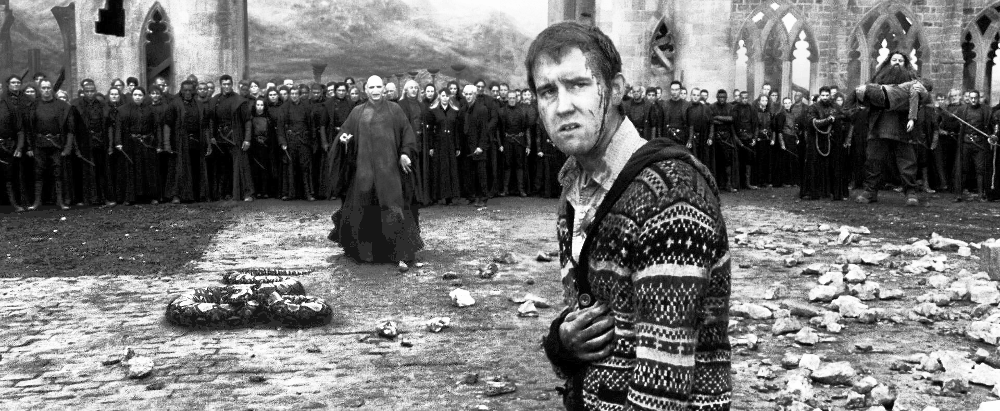

In [ ]:
stitchfinal(gammaTransform9(histEqualization(q9nev1), 2), gammaTransform9(histEqualization(q9nev2), 0.8), gammaTransform9(histEqualization(q9nev3), 1.6), gammaTransform9(histEqualization(q9nev4), 1))